# Find and analyse drought events

To analyse drought events we need to set baselines for drought events. The features we focus on are the duration of each drought and the area affected. We first need to identify all the historical drought events of the region we focus on and then extract these indexes and subsequently the baselines for the region. These baselines can show us if an event was anomalous.

### Import necessary libraries

In [1]:
import sys
import os
import glob
import xarray as xr
from functools import partial
import datetime
import numpy as np
import plotly.graph_objects as go
import dask.array as da
import pandas as pd
import matplotlib.pyplot as plt
from scipy.ndimage import label, generate_binary_structure
import geopandas as gpd
import pandas as pd
from scipy.ndimage import label, generate_binary_structure
import hvplot.xarray  # to plot xarray with hvplot
import cartopy.crs as ccrs
import sys
from pyprojroot import here
root = here()
sys.path.append(str(root / "chapters/shared/"))
from utils.widgets_handler import read_json_to_dict
color_palette_json = 'color_palette_bright.json'
cmap = read_json_to_dict(color_palette_json)
cmap['No Data'] = '#cccccc'

## Load data function

In [2]:
def get_spi_dataset(acc_period: str = 1, years: list = [2020]):
    data_root_folder = '/data1/drought_dataset/spi/'
    spi_folder = os.path.join(data_root_folder, f'spi{acc_period}')
    spi_paths = []

    for year in years:
        spi_paths.extend(sorted(glob.glob(
            f'{data_root_folder}spi{acc_period}/SPI{acc_period}_gamma_global_era5_moda_ref1991to2020_{year}*.nc')))

    return xr.open_mfdataset(spi_paths, chunks={'time': "auto"}, concat_dim="time", combine='nested', parallel=False)


def get_spei_dataset(acc_period: str = 1, years: list = [2020]):
    data_root_folder = '/data1/drought_dataset/spei/'
    spi_folder = os.path.join(data_root_folder, f'spi{acc_period}')
    spi_paths = []

    for year in years:
        spi_paths.extend(sorted(glob.glob(
            f'{data_root_folder}spei{acc_period}/SPEI{acc_period}_genlogistic_global_era5_moda_ref1991to2020_{year}*.nc')))

    return xr.open_mfdataset(spi_paths, chunks={'time': "auto"}, concat_dim="time", combine='nested', parallel=False)


def mask_invalid_values(ds, variable, value=-9999):
    ds[variable] = ds[variable].where(ds[variable] != value, np.nan)
    return ds


def subset_region(dataset, variable, bbox):
    # data = dataset.sel(time=np.datetime64(time), method='nearest')[variable]

    # Define the geographical boundaries for Madagascar
    lat_bounds = [bbox[1], bbox[3]]  # from south to north
    lon_bounds = [bbox[0], bbox[2]]  # from west to east

    # Check for NaN values in latitude and longitude coordinates
    lat_nan = dataset['lat'].isnull().any()
    lon_nan = dataset['lon'].isnull().any()

    # Handle NaN values if they exist
    if lat_nan:
        dataset = dataset.dropna(dim='lat', how='all')
    if lon_nan:
        dataset = dataset.dropna(dim='lon', how='all')

    # Ensure no NaN values in the data itself
    dataset = dataset.fillna(np.nan)  # or use another appropriate method like interpolation

    # Ensure the lat/lon bounds are within the data's range
    lat_min, lat_max = dataset['lat'].min().item(), dataset['lat'].max().item()
    lon_min, lon_max = dataset['lon'].min().item(), dataset['lon'].max().item()

    if lat_bounds[0] < lat_min or lat_bounds[1] > lat_max or lon_bounds[0] < lon_min or lon_bounds[1] > lon_max:
        raise ValueError("The specified latitude/longitude bounds are outside the range of the dataset.")

    # Subset the data using where and dropna
    dataset = dataset.where(
        (dataset['lat'] >= lat_bounds[0]) & (dataset['lat'] <= lat_bounds[1]) &
        (dataset['lon'] >= lon_bounds[0]) & (dataset['lon'] <= lon_bounds[1]),
        drop=True
    )

    # return xr.Dataset(data)
    return dataset
    
def get_spei_significance_dataset(variable='SPEI1', year=2020):
    data_root_folder='/data1/drought_dataset/spei/'
    quality_paths = []
    for month in range(1, 13):
        month_str = f'{month:02d}'
        quality_paths.append(f'{data_root_folder}{variable.lower()}/parameter/{variable}_significance_global_era5_moda_{year}{month_str}_ref1991to2020.nc')
    return xr.open_mfdataset(quality_paths, concat_dim="time", combine='nested', parallel=False)

def get_spi_significance_dataset(variable='SPI1', year=2020):
    data_root_folder='/data1/drought_dataset/spi/'
    quality_paths = []
    for month in range(1, 13):
        month_str = f'{month:02d}'
        quality_paths.append(f'{data_root_folder}{variable.lower()}/parameter/{variable}_significance_global_era5_moda_{year}{month_str}_ref1991to2020.nc')
    return xr.open_mfdataset(quality_paths, concat_dim="time", combine='nested', parallel=False)

## Load dataset

In [3]:
# Load dataset
spei_data = get_spei_dataset(acc_period=12, years=list(range(1940, 2025)))
spei48_region = mask_invalid_values(spei_data, variable='SPEI12')

## Filter dataset for specific bounding box

In [4]:
# Get a subset of the dataset for a bbox
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
world = world.to_crs(epsg=4326)
# country_list = world['name'].unique().tolist()
# country_list.sort()
# country_shape = world[world['name'] == 'Kenya']
# country_shape = world[world['name'] == 'S. Sudan']
country_shape = world[world['name'] == 'S. Sudan']
spei_data = spei_data.rio.write_crs("EPSG:4326", inplace=True)

spei_data_country = spei48_region.rio.clip(country_shape.geometry, world.crs, drop=True)
spei = spei_data_country['SPEI12']

/tmp/ipykernel_2521754/3093083712.py:2: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


## Plot animated SPEI dataset 

In [5]:
spei.hvplot(
    clim=(-8,8),
    groupby="time",
    widget_type="scrubber", 
    widget_location="bottom", 
    projection=ccrs.PlateCarree(), 
    coastline='10m',
    cmap='BrBG',
    features=['borders']
)

Column
    [0] HoloViews(DynamicMap, sizing_mode='fixed', widget_location='bottom', widget_type='scrubber')
    [1] WidgetBox(align=('center', 'end'))
        [0] Player(end=1008, width=550)

## Setup drought severity classification function and classes

### Analyse each month and find the area coverage for each condition. The month classification is the worst condition that covers at least a percentage of the area.

The classes are as bellow:
- 'Extremely dry': $SPEI < -2$
- 'Severely dry': $-2 < SPEI < -1.5$
- 'Moderately dry': $-1.5 < SPEI < -1$
- 'Mildly dry': $-1 < SPEI < 0$
- 'Mildly wet': $0 < SPEI < 1$
- 'Moderately wet': $1 < SPEI < 1.5$
- 'Severely wet': $1.5 < SPEI < 2$
- 'Extremely wet': $SPEI < 2$

In [6]:
import xarray as xr
import numpy as np


def classify_drought_severity(spei, classes, conditions, threshold_percentage=50):
    """
    Classifies drought severity based on SPEI values and percentage of grid points in each class.

    Parameters:
    - spei: An xarray DataArray containing SPEI values (dimensions: time, lat, lon).
    - classes: A list of class names (e.g., ['Extreme Drought', 'Severe Drought', ...]).
    - conditions: A list of conditions corresponding to each class (Boolean conditions for the grid).
    - threshold_percentage: Minimum percentage of grid points required to classify a time step into a specific class.

    Returns:
    - result_df: A pandas DataFrame with counts and percentages of grid points in each class for each time step,
      including a 'Final Classification' column based on the percentage threshold.
    """
    
    # Calculate the total number of grid points (excluding NaN values if any)
    total_grid_points = spei.notnull().sum(dim=['lat', 'lon'])
    
    # Count the number of grid points in each condition for each time step
    counts = [condition.sum(dim=['lat', 'lon']) for condition in conditions]

    # Combine counts along a new dimension called 'class'
    counts_concat = xr.concat(counts, dim=pd.Index(classes, name="class"))

    # Convert to DataFrame
    counts_df = counts_concat.to_dataframe(name='count').reset_index()

    # Pivot the DataFrame to have classes as columns
    result_df = counts_df.pivot(index='time', columns='class', values='count').fillna(0)

    # Add total grid points to the result DataFrame
    result_df['Total Grid Points'] = total_grid_points.values

    # Calculate the percentage of grid points for each class
    for class_name in classes:
        result_df[f'{class_name} Percentage'] = (result_df[class_name] / result_df['Total Grid Points']) * 100

    # Determine the final classification for each time step based on the percentage threshold
    def classify_row(row):
        for class_name in classes:
            if row[f'{class_name} Percentage'] >= threshold_percentage:
                return class_name
        return 'No Data'  # If no class meets the threshold

    result_df['Final Classification'] = result_df.apply(classify_row, axis=1)

    return result_df

# Example usage
# Load the dataset (assuming it's already in xarray format)
# ds = xr.open_dataset('your_dataset.nc')  # Uncomment if loading from file
# spei = ds['SPEI']  # Replace 'SPEI' with your actual variable name

# Define the conditions and corresponding classes
conditions = [
    spei < -2, # 'Extremely dry'
    (spei >= -2) & (spei < -1.5), # 'Severely dry'
    (spei >= -1.5) & (spei < -1), # 'Moderately dry'
    (spei >= -1) & (spei < 0), # 'Mildly dry'
    (spei >= 0) & (spei <= 1), # 'Mildly wet'
    (spei >= 1) & (spei <= 1.5), # 'Moderately wet'
    (spei >= 1.5) & (spei <= 2), # 'Severely wet'
    spei > 2 # 'Extremely wet'
]
classes = ['Extremely dry', 
           'Severely dry', 
           'Moderately dry', 
           'Mildly dry', 
           'Mildly wet', 
           'Moderately wet', 
           'Severely wet', 
           'Extremely wet']

### Classify months in SPEI

In [7]:
# Get the result DataFrame
result_df = classify_drought_severity(spei, classes, conditions, threshold_percentage=20)
result_df = result_df.reset_index()
# Output the result
result_df

class,time,Extremely dry,Extremely wet,Mildly dry,Mildly wet,Moderately dry,Moderately wet,Severely dry,Severely wet,Total Grid Points,Extremely dry Percentage,Severely dry Percentage,Moderately dry Percentage,Mildly dry Percentage,Mildly wet Percentage,Moderately wet Percentage,Severely wet Percentage,Extremely wet Percentage,Final Classification
0,1940-01-01 06:00:00,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,No Data
1,1940-02-01 06:00:00,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,No Data
2,1940-03-01 06:00:00,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,No Data
3,1940-04-01 06:00:00,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,No Data
4,1940-05-01 06:00:00,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,No Data
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1004,2023-09-01 06:00:00,756,0,5,0,13,0,44,0,818,92.420538,5.378973,1.589242,0.611247,0.000000,0.0,0.0,0.0,Extremely dry
1005,2023-10-01 06:00:00,723,0,14,0,27,0,54,0,818,88.386308,6.601467,3.300733,1.711491,0.000000,0.0,0.0,0.0,Extremely dry
1006,2023-11-01 06:00:00,644,0,33,2,41,0,98,0,818,78.728606,11.980440,5.012225,4.034230,0.244499,0.0,0.0,0.0,Extremely dry
1007,2023-12-01 06:00:00,647,0,34,1,38,0,98,0,818,79.095355,11.980440,4.645477,4.156479,0.122249,0.0,0.0,0.0,Extremely dry


 #### Generate barplot for the dataset to visuallize drought events

In [8]:
# import matplotlib.pyplot as plt
# import pandas as pd
# import numpy as np
# import matplotlib.dates as mdates

# # Map the classifications to colors
# result_df['Color'] = result_df['Final Classification'].map(cmap)

# # Create the plot
# plt.figure(figsize=(12, 4))  # Adjust the width and height of the plot

# # Plot bars
# plt.bar(result_df['time'], 1, color=result_df['Color'], width=60, align='edge')  # Adjust width for visibility

# # Customize x-axis and y-axis
# plt.gca().yaxis.set_visible(False)  # Hide y-axis

# # Set x-axis major locator and formatter to show only yearly ticks
# plt.gca().xaxis.set_major_locator(mdates.YearLocator())  # Place ticks at yearly intervals
# plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y'))  # Format x-axis labels to show only year

# # Set x-axis limits
# plt.xlim(pd.Timestamp(result_df.time.min()), pd.Timestamp(result_df.time.max()))

# # Rotate x-axis labels for better readability
# plt.xticks(rotation=90)

# # Label the x-axis
# plt.xlabel('Time')

# # Set the title of the plot
# plt.title('Drought Classification Over Time')

# # Add legend
# handles = [plt.Line2D([0], [0], color=color, lw=4) for color in cmap.values()]
# labels = list(cmap.keys())
# plt.legend(handles, labels, title='Drought Classification', bbox_to_anchor=(1.05, 1), loc='upper left')

# # Adjust layout for better fit
# plt.tight_layout()

# # Show the plot
# plt.show()

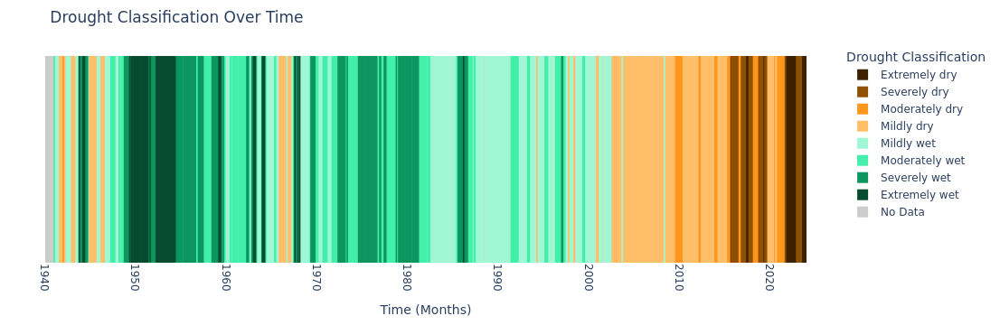

In [38]:
import plotly.graph_objs as go
import pandas as pd
import numpy as np

# Map the classifications to colors
result_df['Color'] = result_df['Final Classification'].map(cmap)

# Create the plot
fig = go.Figure()

legend_order = [
    'Extremely dry', 'Severely dry', 'Moderately dry', 'Mildly dry',
    'Mildly wet', 'Moderately wet', 'Severely wet', 'Extremely wet',
    'No Data'
]

# Add bars
for lbl in legend_order:
    fig.add_trace(go.Bar(
        x=result_df['time'].loc[result_df['Final Classification']==lbl],
        y=[1] * len(result_df),
        name=lbl,
        marker=dict(color=result_df['Color'].loc[result_df['Final Classification']==lbl], line=dict(width=0)),
        width=60 * 24 * 60 * 60 * 1000,  # Width in milliseconds
        orientation='v',  # Vertical bars
        # name='Drought Classification'
    ))

x_min = result_df['time'].min()
x_max = result_df['time'].max()

# Update x-axis and y-axis
fig.update_xaxes(
    title_text='Time (Months)',
    tickformat='%Y',  # Format x-axis labels to show only year
    tickangle=90,  # Rotate x-axis labels
    rangeslider_visible=False,  # Hide the range slider
    type='date',# Ensure x-axis is treated as dates
    range=[x_min, x_max]
)

fig.update_yaxes(
    visible=False  # Hide y-axis
)

# Add legend
fig.update_layout(
    title='Drought Classification Over Time',
    legend_title='Drought Classification',
    legend=dict(
        x=1.05,  # Positioning the legend to the right of the plot
        y=1,
        orientation='v',
        traceorder='normal'  # Ensure legend entries are in the order they appear in the plot
    ),
    margin=dict(l=50, r=200, t=50, b=50),
    paper_bgcolor='white',
    plot_bgcolor='white',
    font=dict(
        color='#2a3f5f',
        family='sans-serif'
    ),
)

# Show the plot
fig.show()

## Setup function to detect continuous periods of a condition

A drought event is defined as continuous periods of at least midly dry condition. Periods that are separated by a threshold number of months (default to 1) count as one event.

In [10]:
def detect_continuous_periods_with_dates(df, binary_col, date_col, min_sep=1):
    """
    Detects continuous periods of 1s in a binary vector within a DataFrame and returns a new DataFrame
    with the start date, end date, and duration of each period.
    
    Parameters:
    - df: Input DataFrame containing the binary vector and dates.
    - binary_col: Column name for the binary vector (0s and 1s).
    - date_col: Column name for the corresponding dates.
    - min_sep: Minimum number of continuous 0s required to separate periods of 1s.
    
    Returns:
    - periods_df: A DataFrame with 'Start Date', 'End Date', and 'Duration' columns.
    """
    
    # Ensure binary_col is binary (0s and 1s)
    assert df[binary_col].isin([0, 1]).all(), "The binary column must contain only 0s and 1s."
    
    # Detect transitions in the binary column
    transitions = df[binary_col].diff().fillna(0)
    
    # Find where the vector changes from 0 to 1 (start of 1s) and 1 to 0 (end of 1s)
    start_ones = transitions == 1
    end_ones = transitions == -1
    
    # Get the indices of these transitions
    start_indices = start_ones[start_ones].index
    end_indices = end_ones[end_ones].index
    
    # If the series starts with 1s, add a start at the beginning
    if df[binary_col].iloc[0] == 1:
        start_indices = pd.Index([df.index[0]]).append(start_indices)
    
    # If the series ends with 1s, add an end at the end
    if df[binary_col].iloc[-1] == 1:
        end_indices = end_indices.append(pd.Index([df.index[-1]]))
    
    # Ensure indices are aligned
    assert len(start_indices) == len(end_indices), "Mismatched start and end periods."
    
    # Filter out periods that are too close to each other based on min_sep
    valid_periods = []
    last_end = -min_sep - 1  # Initialize last_end to be far enough back
    
    for start, end in zip(start_indices, end_indices):
        if start - last_end >= min_sep:
            valid_periods.append((start, end))
        last_end = end
    
    # Create a new DataFrame for the detected periods
    periods = []
    for start, end in valid_periods:
        start_date = df.loc[start, date_col]
        end_date = df.loc[end, date_col]
        duration = (end_date.year - start_date.year) * 12 + end_date.month - start_date.month + 1  # Duration in months
        periods.append({'Start Date': start_date, 'End Date': end_date, 'Duration': duration})
    
    periods_df = pd.DataFrame(periods)
    return periods_df

## Convert the timeline to a binary vector. 
Every dry condition is marked as drought and everything else as no drought. A minimum separation of 2 months with no drought is regarded as no change.

In [37]:
min_sep = 1  # Minimum separation of 1 zeros to consider periods distinct

result_df['class'] = np.where((result_df['Final Classification']=='Extremely dry')|
                              (result_df['Final Classification']=='Severely dry')|
                              (result_df['Final Classification']=='Moderately dry')|
                              (result_df['Final Classification']=='Mildly dry'), 1, 0)

## Find the continuous periods and calculate their duration

In [36]:
periods_df = detect_continuous_periods_with_dates(result_df, binary_col='class', date_col='time', min_sep=min_sep)
periods_df

,Start Date,End Date,Duration
0,1941-07-01 06:00:00,1942-05-01 06:00:00,11
1,1942-11-01 06:00:00,1943-06-01 06:00:00,8
2,1944-11-01 06:00:00,1945-10-01 06:00:00,12
3,1946-02-01 06:00:00,1946-09-01 06:00:00,8
4,1965-10-01 06:00:00,1966-09-01 06:00:00,12
5,1966-10-01 06:00:00,1967-04-01 06:00:00,7
6,1988-06-01 06:00:00,1988-07-01 06:00:00,2
7,1991-03-01 06:00:00,1991-04-01 06:00:00,2
8,1994-03-01 06:00:00,1994-06-01 06:00:00,4
9,1997-09-01 06:00:00,1997-12-01 06:00:00,4


## Plot all the event durations and find the 75 percentile to find drought events with an anomalous duration

Events with a duration more than the 75 percentile can be characterized as very anomalous. For S.Sudan one such drought event was between July 2002 and September 2003.

In [13]:
# def plot_duration_bar_plot(data, percentile=75):
#     percentile_9_duration = np.percentile(data.Duration, 90)
#     percentile_1_duration = np.percentile(data.Duration, 10)
#     median_duration = data.Duration.median()
    
    
#     # Create the plot
#     plt.figure(figsize=(10, 6))
    
#     # Create bars for each event
#     bars = plt.bar(data.index, data['Duration'], color='skyblue', edgecolor='black')
    
#     # Add a dashed red line for the average duration
#     plt.axhline(y=percentile_9_duration, color='red', linestyle='--', linewidth=2, label=f'{90} percentile of durations: {percentile_9_duration:.2f} months')
#     plt.axhline(y=percentile_1_duration, color='green', linestyle='--', linewidth=2, label=f'{10} percentile of durations: {percentile_1_duration:.2f} months')
#     plt.axhline(y=median_duration, color='blue', linestyle='--', linewidth=2, label=f'Median duration: {median_duration:.2f} months')
    
#     # Labeling the x-axis ticks with the start and end dates
#     xticks_labels = [f"{start.strftime('%Y-%m')} - {end.strftime('%Y-%m')}" for start, end in zip(data['Start Date'], data['End Date'])]
#     plt.xticks(ticks=np.arange(len(data.index)), labels=xticks_labels)
    
#     # Label axes
#     plt.xlabel('Events')
#     plt.ylabel('Duration (Months)')
#     plt.title('Duration of drought events in history')
    
#     # Add legend
#     plt.legend()
    
#     # Rotate x-axis labels for better readability
#     plt.xticks(rotation=45, ha='right')
    
#     # Adjust layout for better fit
#     plt.tight_layout()
    
#     # Show the plot
#     plt.show()

In [14]:
# plot_duration_bar_plot(periods_df)

In [15]:

def plot_duration_bar_plot(data, percentile=75):
    percentile_9_duration = np.percentile(data.Duration, 90)
    percentile_1_duration = np.percentile(data.Duration, 10)
    median_duration = data.Duration.median()

    # Generate x-axis labels based on the dates
    x_labels = [f"{start.strftime('%Y-%m')} - {end.strftime('%Y-%m')}" for start, end in zip(data['Start Date'], data['End Date'])]

    # Create a numerical x-axis for the plot
    x_numeric = list(range(len(x_labels)))

    # Create bars for each event
    bar = go.Bar(
        x=x_numeric,
        y=data['Duration'],
        marker=dict(color='skyblue', line=dict(color='black', width=1)),
        name='Event period',
    )
    
    # Define the x-axis range for the lines
    line_x_values = [x_numeric[0] - 1, x_numeric[-1] + 1]  # Extend beyond the first and last data point
    
    # Create lines for percentiles and median
    percentile_9_line = go.Scatter(
        x=line_x_values,
        y=[percentile_9_duration, percentile_9_duration],
        mode='lines',
        line=dict(color='red', dash='dash'),
        name=f'90th percentile: {percentile_9_duration:.2f} months'
    )
    
    percentile_1_line = go.Scatter(
        x=line_x_values,
        y=[percentile_1_duration, percentile_1_duration],
        mode='lines',
        line=dict(color='green', dash='dash'),
        name=f'10th percentile: {percentile_1_duration:.2f} months'
    )
    
    median_line = go.Scatter(
        x=line_x_values,
        y=[median_duration, median_duration],
        mode='lines',
        line=dict(color='blue', dash='dash'),
        name=f'Median: {median_duration:.2f} months'
    )
    
    # Create the layout
    layout = go.Layout(
        title='Duration of drought events',
        xaxis=dict(
            title='Events',
            tickangle=-45,
            tickmode='array',
            tickvals=x_numeric,
            ticktext=x_labels,
            range=[x_numeric[0] - 1, x_numeric[-1] + 1],  # Extend x-axis range
        ),
        yaxis=dict(title='Duration (Months)'),
        barmode='group',
        legend=dict(x=1, y=0.5, orientation='v'),
        margin=dict(l=50, r=50, t=50, b=100),
        paper_bgcolor='white', 
        plot_bgcolor='white',
        font=dict(
            color='#2a3f5f',
            family='sans-serif'
            ),
    )
    
    # Create the figure and add the traces
    fig = go.Figure(data=[bar, percentile_9_line, percentile_1_line, median_line], layout=layout)
    
    # Show the plot
    fig.show()

In [16]:
plot_duration_bar_plot(periods_df)

## Calculate area percentage for each class for each month and aggregate for each event

In [17]:
def calculate_area_percentage(monthly_data, periods):
    columns_to_use = ['Extremely dry',
                     'Severely dry', 
                     'Moderately dry',
                     'Mildly dry', 
                     'Mildly wet', 
                     'Moderately wet',
                     'Severely wet',
                     'Extremely wet']
    
    new_columns = ['Extremely dry %',
                   'Severely dry %', 
                   'Moderately dry %',
                   'Mildly dry %',
                   'Mildly wet %', 
                   'Moderately wet %',
                   'Severely wet %',
                   'Extremely wet %']
    
    rows = []
    for i, row in periods.iterrows():
        start_date = row['Start Date']
        end_date = row['End Date']
        df = monthly_data.loc[(monthly_data.time >= start_date) & (monthly_data.time <= end_date)]
        total = df[columns_to_use].sum(axis=1)
        # Calculate the percentage for each specified column
        df_percentage = df[columns_to_use].div(total, axis=0) * 100
        cols = {i[0]:i[1] for i in zip(columns_to_use, new_columns)}
        df_percentage.rename(columns=cols,inplace=-True)
        # Add the percentage columns back to the original dataframe, if needed
        df.loc[:, new_columns] = df_percentage
        rows.append(df[new_columns].mean(axis=0))
    new_df = pd.concat(rows, axis=1).T.reset_index(drop=True)
    new_df['Start Date'] = periods['Start Date']
    new_df['End Date'] = periods['End Date']
    return new_df

In [18]:
percentages = calculate_area_percentage(result_df, periods_df)

In [19]:
percentages

class,Extremely dry %,Severely dry %,Moderately dry %,Mildly dry %,Mildly wet %,Moderately wet %,Severely wet %,Extremely wet %,Start Date,End Date
0,0.522338,4.156479,11.658146,53.723050,29.228717,0.700156,0.011114,0.000000,1941-07-01 06:00:00,1942-05-01 06:00:00
1,2.444988,5.684597,8.175428,27.735330,48.960880,4.859413,1.589242,0.550122,1942-11-01 06:00:00,1943-06-01 06:00:00
2,1.629992,4.024042,7.620212,45.069275,38.457620,2.485738,0.550122,0.162999,1944-11-01 06:00:00,1945-10-01 06:00:00
3,0.702934,1.191932,4.003667,28.896699,61.048289,3.438264,0.473716,0.244499,1946-02-01 06:00:00,1946-09-01 06:00:00
4,5.063162,1.996740,3.249796,28.698044,44.947025,10.431948,3.942543,1.670742,1965-10-01 06:00:00,1966-09-01 06:00:00
5,0.061125,0.000000,0.000000,12.958435,75.611247,8.985330,2.322738,0.061125,1988-06-01 06:00:00,1988-07-01 06:00:00
6,0.000000,0.000000,0.122249,13.630807,57.762836,23.349633,5.012225,0.122249,1991-03-01 06:00:00,1991-04-01 06:00:00
7,1.344743,2.139364,4.828851,29.217604,61.308068,1.161369,0.000000,0.000000,1994-03-01 06:00:00,1994-06-01 06:00:00
8,0.244499,0.275061,2.414425,20.690709,54.125917,21.943765,0.305623,0.000000,1997-09-01 06:00:00,1997-12-01 06:00:00
9,0.097800,0.000000,0.855746,30.268949,63.960880,4.523227,0.293399,0.000000,1998-04-01 06:00:00,1998-08-01 06:00:00


In [20]:
percentages['Dry'] = percentages.loc[:, ['Extremely dry %', 'Severely dry %', 'Moderately dry %', 'Mildly dry %']].sum(axis=1)

In [21]:
percentages

class,Extremely dry %,Severely dry %,Moderately dry %,Mildly dry %,Mildly wet %,Moderately wet %,Severely wet %,Extremely wet %,Start Date,End Date,Dry
0,0.522338,4.156479,11.658146,53.723050,29.228717,0.700156,0.011114,0.000000,1941-07-01 06:00:00,1942-05-01 06:00:00,70.060013
1,2.444988,5.684597,8.175428,27.735330,48.960880,4.859413,1.589242,0.550122,1942-11-01 06:00:00,1943-06-01 06:00:00,44.040342
2,1.629992,4.024042,7.620212,45.069275,38.457620,2.485738,0.550122,0.162999,1944-11-01 06:00:00,1945-10-01 06:00:00,58.343521
3,0.702934,1.191932,4.003667,28.896699,61.048289,3.438264,0.473716,0.244499,1946-02-01 06:00:00,1946-09-01 06:00:00,34.795232
4,5.063162,1.996740,3.249796,28.698044,44.947025,10.431948,3.942543,1.670742,1965-10-01 06:00:00,1966-09-01 06:00:00,39.007742
5,0.061125,0.000000,0.000000,12.958435,75.611247,8.985330,2.322738,0.061125,1988-06-01 06:00:00,1988-07-01 06:00:00,13.019560
6,0.000000,0.000000,0.122249,13.630807,57.762836,23.349633,5.012225,0.122249,1991-03-01 06:00:00,1991-04-01 06:00:00,13.753056
7,1.344743,2.139364,4.828851,29.217604,61.308068,1.161369,0.000000,0.000000,1994-03-01 06:00:00,1994-06-01 06:00:00,37.530562
8,0.244499,0.275061,2.414425,20.690709,54.125917,21.943765,0.305623,0.000000,1997-09-01 06:00:00,1997-12-01 06:00:00,23.624694
9,0.097800,0.000000,0.855746,30.268949,63.960880,4.523227,0.293399,0.000000,1998-04-01 06:00:00,1998-08-01 06:00:00,31.222494


In [22]:
def plot_area_bar_plot(data, columns_to_sum=['Moderately dry %',
                                             'Mildly dry %',
                                             'Mildly wet %',
                                             'Moderately wet %',
                                             'Severely wet %',
                                             'Extremely wet %']):
    columns = [i for i in data.columns if '%' in i and i not in columns_to_sum]

    fig = go.Figure()
    x_axis_labels =  [f"{start.strftime('%Y-%m')} - {end.strftime('%Y-%m')}" for start, end in zip(data['Start Date'], data['End Date'])]

    # Adding bars for each category
    if columns_to_sum:
        fig.add_trace(go.Bar(
            x=x_axis_labels,
            y=data[columns_to_sum].sum(axis=1),
            name='Normal',
            marker=dict(color=cmap['Severely wet'], line=dict(width=0))
        ))
    for category in columns[::-1]:
        fig.add_trace(go.Bar(
            x=x_axis_labels,
            y=data[category],
            name=category[:-2],
            marker=dict(color=cmap[category[:-2]])
        ))
    
    # Updating the layout for stacked bar
    fig.update_layout(
        barmode='stack',  # This ensures the bars are stacked
        title='Area of each type of drought',
        xaxis=dict(title='Events',
                   tickangle=-45,  # Rotate the x-axis labels by -45 degrees
                   tickmode='array',
                   tickvals=x_axis_labels,
                   ticktext=x_axis_labels,),
        yaxis=dict(title='Percentage'),
        legend=dict(orientation='v',x=1, y=0.5),
        margin=dict(l=50, r=50, t=50, b=100),
        paper_bgcolor='white',  # Transparent background for the entire paper
        plot_bgcolor='white',
        font=dict(
            color='#2a3f5f',
            family='sans-serif'
            ),
        bargap=0
    )
    
    # Show the plot
    fig.show()

In [23]:
plot_area_bar_plot(percentages, columns_to_sum=[])

In [24]:
plot_area_bar_plot(percentages)

#### Plot durations for each grid point on map for drought event 1

In [25]:
event_1 = periods_df.iloc[4]
event_data = spei.loc[event_1['Start Date'].isoformat():event_1['End Date'].isoformat()]

In [26]:
# condition = event_data < -1.5
nan_mask = np.isnan(event_data)
condition = xr.where(nan_mask, np.nan, event_data < -1.5)

In [27]:
occurrences_xr = condition.sum(dim='time')
occurrences_xr = occurrences_xr.rio.write_crs("EPSG:4326", inplace=True)
occurrences_xr = occurrences_xr.rio.set_spatial_dims(x_dim='lon', y_dim='lat')
occurrences_xr = occurrences_xr.rio.clip(country_shape.geometry, world.crs, drop=True)

In [28]:
occurrences_xr.hvplot(
    widget_type="scrubber", 
    widget_location="bottom", 
    projection=ccrs.PlateCarree(), 
    coastline='10m',
    cmap='BrBG_r',
    features=['borders']
)

HoloViews(Overlay, sizing_mode='fixed', widget_location='bottom', widget_type='scrubber')

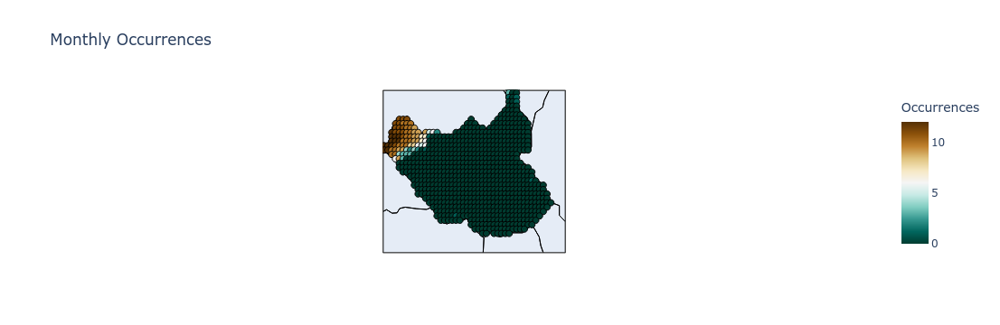

In [30]:
# Mask area outside of aoi shape
nan_mask = np.isnan(event_data)
result = xr.where(nan_mask, np.nan, occurrences_xr)
result = result.rio.write_crs("EPSG:4326", inplace=True)
result = result.rio.set_spatial_dims(x_dim='lon', y_dim='lat')
result = result.rio.clip(country_shape.geometry, world.crs, drop=True)
df = occurrences_xr.to_dataframe().reset_index()
df = df.dropna(subset=['lat', 'lon', 'SPEI12'])

# Extract the latitude, longitude, and occurrence data
lat = df['lat'].values
lon = df['lon'].values
occurrences = df['SPEI12'].values

# Create the base map with country borders
fig = go.Figure(go.Scattergeo(
    locationmode = 'country names',
    lon = lon,
    lat = lat,
    text = occurrences,
    marker = dict(
        size = 7,
        color = occurrences, # Use occurrences for color
        colorscale = 'BrBG_r',
        showscale = True,
        colorbar=dict(title="Occurrences"),
        line=dict(width=1, color='black')
    )
))

# Update the layout for better visibility
fig.update_layout(
    # width=1200,  # Increase plot width
    # height=800,  # Increase plot height
    geo=dict(
        scope='world',
        projection_type='natural earth',
        showcoastlines=True,
        showcountries=True,
        countrycolor="Black",
        coastlinecolor="Black",
        
        # Define the region of interest by setting lat/lon bounds
        lonaxis=dict(range=[lon.min()-0.5, lon.max()+0.5]),  # Longitude bounds
        lataxis=dict(range=[lat.min()-0.5, lat.max()+0.5]),  # Latitude bounds
        
        # Optionally, you can specify the center of the map
        center=dict(lon=lon.mean(), lat=lat.mean()),  # Center of the map
    ),
    title="Monthly Occurrences",
)

# Show the plot
fig.show()

#### Group durations of each grid point in groups:
- Up to 1 month
- Up to 3 months
- Up to 6 months
- More than 6 months

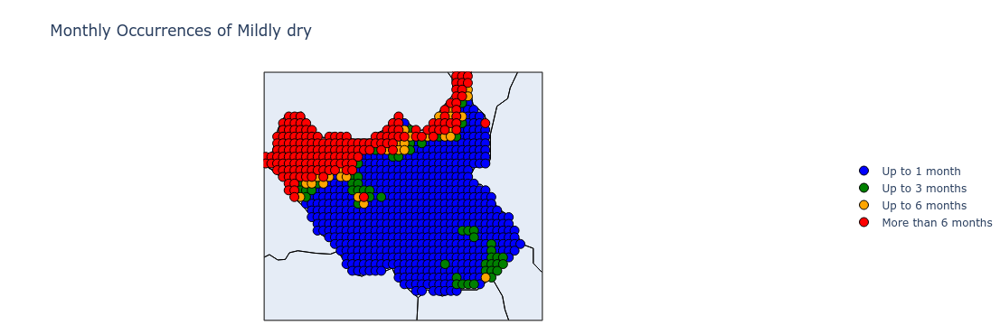

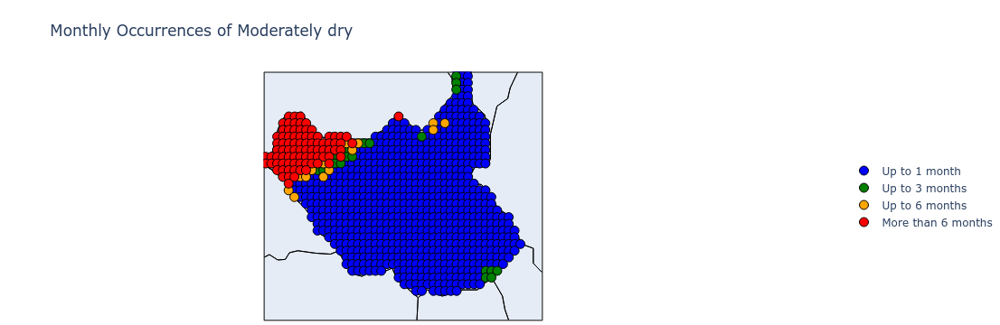

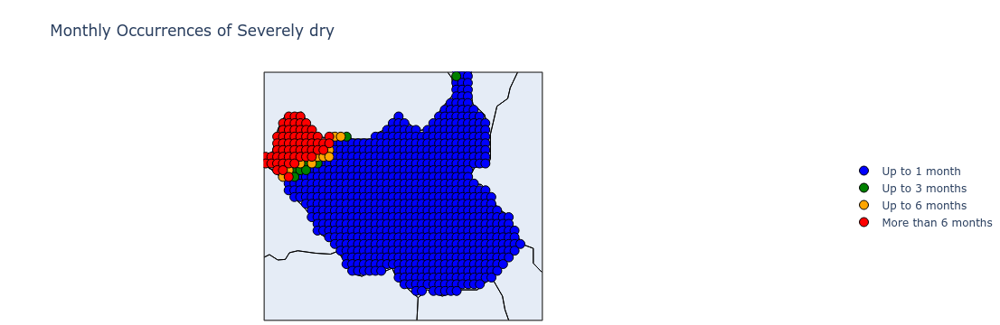

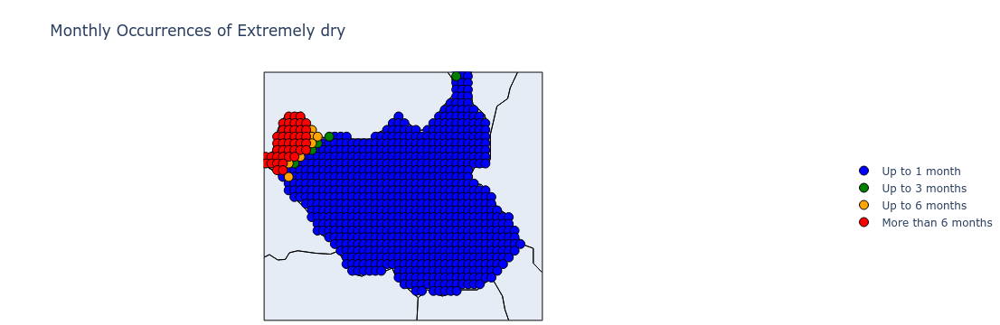

In [32]:
from plotly.subplots import make_subplots

conditions = [
    (lambda x: x < -0.5, 'Mildly dry'),
    (lambda x: x < -1, 'Moderately dry'), 
    (lambda x: x < -1.5, 'Severely dry'), 
    (lambda x: x < -2, 'Extremely dry')
]



def categorize_occurrences(x):
    if np.isnan(x):
        return 'No data'
    elif x <= 1:
        return 'Up to 1 month'
    elif x <= 3:
        return 'Up to 3 months'
    elif x <= 6:
        return 'Up to 6 months'
    else:
        return 'More than 6 months'

def add_traces_to_subplot(fig, df):
    df = df.dropna(subset=['lat', 'lon', 'category'])
    lat = df['lat'].values
    lon = df['lon'].values
    category = df['category'].values

    color_map = {
        # 'No data': 'white',
        'Up to 1 month': 'blue',
        'Up to 3 months': 'green',
        'Up to 6 months': 'orange',
        'More than 6 months': 'red'
    }
    
    # Plot each category separately to apply different colors
    for cat in color_map:
        mask = df['category'] == cat
        fig.add_trace(go.Scattergeo(
            lon=lon[mask],
            lat=lat[mask],
            text=category[mask],
            mode='markers',
            marker=dict(
                size=10,
                color=color_map[cat],
                opacity=1,
                line=dict(width=1, color='black')
            ),
            name=cat,  # Label for the legend
            showlegend=True  # Control legend visibility
        ))

for condition, description in conditions:
    
    # Apply spei condition
    data = condition(event_data).sum(dim='time')
    
    # Mask area outside of aoi shape
    nan_mask = np.isnan(data)
    result = xr.where(nan_mask, np.nan, data)
    result = result.rio.write_crs("EPSG:4326", inplace=True)
    result = result.rio.set_spatial_dims(x_dim='lon', y_dim='lat')
    result = result.rio.clip(country_shape.geometry, world.crs, drop=True)
    
    fig = go.Figure()

    # Convert xarray to Dataframe and categorize grid point
    df = result.to_dataframe().reset_index()
    df['category'] = df['SPEI12'].apply(categorize_occurrences)

    # Plot data
    add_traces_to_subplot(fig, df)

    # Update the layout: Increase the size and set the geographic scope
    fig.update_layout(
        geo=dict(
                scope='world',
                projection_type='natural earth',
                showcoastlines=True,
                showcountries=True,
                countrycolor="Black",
                coastlinecolor="Black",
                
                # Define the region of interest by setting lat/lon bounds so the plot is zoomed in the AOI
                lonaxis=dict(range=[lon.min() - 0.5, lon.max() + 0.5]),  # Longitude bounds
                lataxis=dict(range=[lat.min() - 0.5, lat.max() + 0.5]),  # Latitude bounds
                
                # Specify the center of the map
                center=dict(lon=lon.mean(), lat=lat.mean()),  # Center of the map
            ),
        title=f"Monthly Occurrences of {description}",
        margin=dict(l=1, r=1, t=80, b=5),
        legend=dict(
            x=1.05,
            y=0.5,
            traceorder='normal',
            orientation='v'
        )
    )
        
    # Show the plot
    fig.show()